Nomes: **Gustavo Pierre** e **Arthur Alegro**

# Entregável 1 - visão computacional

In [1]:
%matplotlib inline
import cv2
from matplotlib import pyplot as plt
import numpy as np
import time as t
print("OpenCV Version : %s " % cv2.__version__)

OpenCV Version : 4.1.1 


# Equalização de histograma

In [2]:
rintin = cv2.imread("RinTinTin.jpg")

In [3]:
rintin.shape

(240, 320, 3)

In [4]:
rintin_gray = cv2.cvtColor(rintin, cv2.COLOR_RGB2GRAY)

In [5]:
rintin_gray.shape

(240, 320)

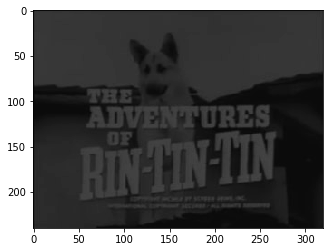

In [6]:
plt.imshow(rintin_gray, cmap="Greys_r", vmin=0, vmax=255)

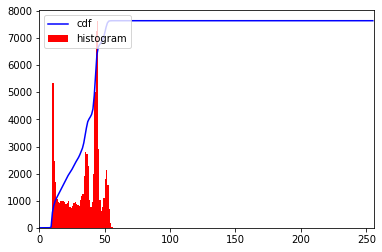

In [7]:

hist,bins = np.histogram(rintin_gray.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()

plt.plot(cdf_normalized, color = 'b')
plt.hist(rintin_gray.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.show()

## Atividade 1

Realize as seguintes atividades:

1. O histograma fornecido aproveita bem as faixas de cores?
2. Crie uma imagem derivada da imagem fornecida que use melhor a faixa dinâmica, ou seja, tenha o valor dos seus pixels distribuídos entre `0` e `255`. 
3. Plote a imagem pedida

8
58


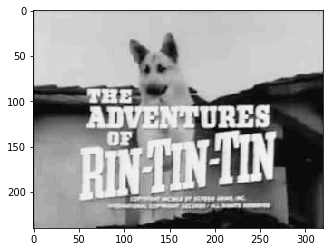

In [8]:
# General normalization calculation:
def normalized_value(value, min_value, max_value, min_new_scale, max_new_scale):
    return min_new_scale + (value - min_value)*(max_new_scale - min_new_scale) / (max_value - min_value)

# Min and Max values from original file:
old_min = min(rintin_gray.flatten())
old_max = max(rintin_gray.flatten())

print(old_min)
print(old_max)
# Min and Max values for normalized file:
new_min = 0
new_max = 255

# Making an empty copy of the original file:
rintin_copy = np.zeros(rintin_gray.shape)

# Iterating and normalizind all pixel values:
for i, line in enumerate(rintin_gray):
    for j, value in enumerate(line):
        rintin_copy[i][j] = int(normalized_value(value, old_min, old_max, new_min, new_max))
        
# Exibiting new file:
plt.imshow(rintin_copy, cmap="Greys_r", vmin=0, vmax=255)
plt.show()

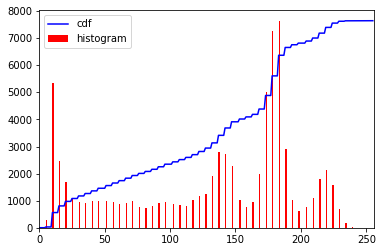

In [9]:
hist,bins = np.histogram(rintin_copy.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()

plt.plot(cdf_normalized, color = 'b')
plt.hist(rintin_copy.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.show()

## Atividade 2

Leia com a OpenCV a figura abaixo:

![](cena_canto_sala.jpg)

Separe os canais  R e B das imagens e analise seus histogramas.

1. A partir dos canais R e B e da análise do histograma é possível identificar a caixa vermelha e o creeper azul?

1. Crie uma imagem numpy em que somente os pixels da caixa vermelha estão brancos e faça seu plot aqui. Você vai precisar usar manipulação de canais RGB. Use o [ExemploFor.ipynb](ExemploFor.ipynb) .


In [10]:
creepers = cv2.cvtColor(cv2.imread("cena_canto_sala.jpg"), cv2.COLOR_BGR2RGB)
creepers.shape

(3024, 4032, 3)

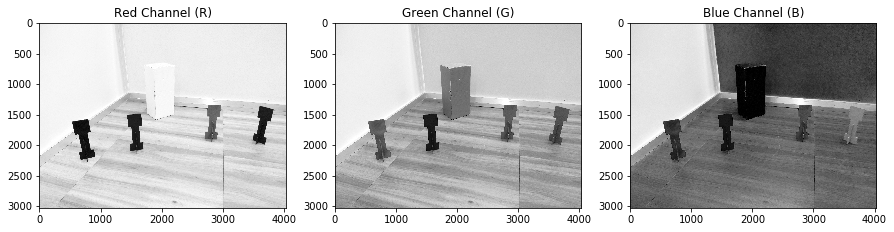

In [11]:
red_channel = creepers[:,:,0]
green_channel = creepers[:,:,1]
blue_channel = creepers[:,:,2]

plt.figure(figsize=(15,6))

plt.subplot(131)
plt.imshow(red_channel, cmap="Greys_r", vmin=0, vmax=255)
plt.title("Red Channel (R)")

plt.subplot(132)
plt.imshow(green_channel, cmap="Greys_r", vmin=0, vmax=255)
plt.title("Green Channel (G)")

plt.subplot(133)
plt.imshow(blue_channel, cmap="Greys_r", vmin=0, vmax=255)
plt.title("Blue Channel (B)")

plt.show()

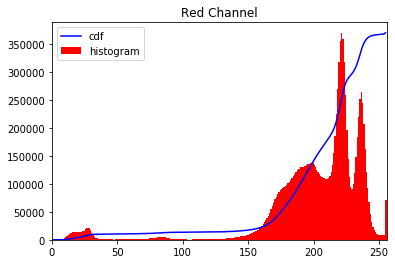

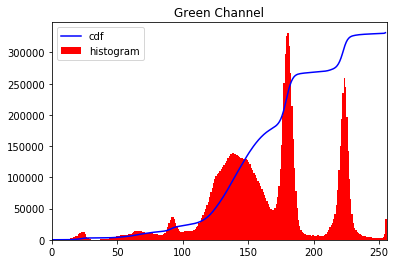

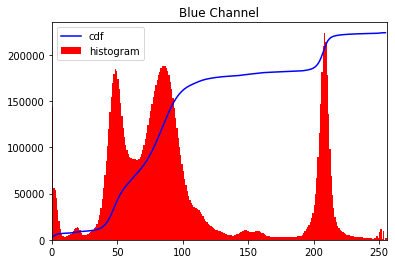

In [12]:
hist,bins = np.histogram(red_channel.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()

plt.plot(cdf_normalized, color = 'b')
plt.hist(red_channel.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.title("Red Channel")
plt.show()


hist,bins = np.histogram(green_channel.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()

plt.plot(cdf_normalized, color = 'b')
plt.hist(green_channel.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.title("Green Channel")
plt.show()


hist,bins = np.histogram(blue_channel.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()

plt.plot(cdf_normalized, color = 'b')
plt.hist(blue_channel.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.title("Blue Channel")
plt.show()

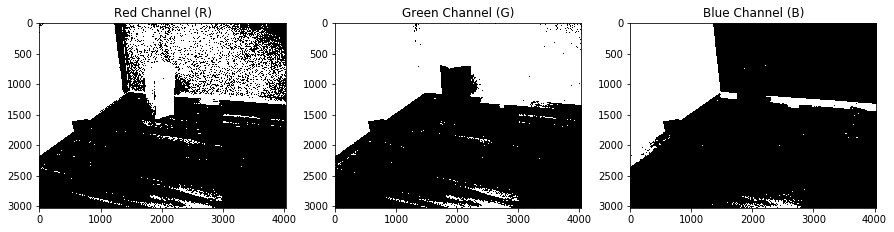

In [13]:
red_filter_value = 220
green_filter_value = 170
blue_filter_value = 120

# Sets to 0 all values lower than a given reference value:
def filter_lower_values(value, ref_value):
    if value < ref_value:
        return 0
    if value >= ref_value:
        return 255
    
# Making an empty copy of each channel:
red_copy = np.zeros(red_channel.shape)
green_copy = np.zeros(green_channel.shape)
blue_copy = np.zeros(blue_channel.shape)

# Iterating and nullifying all pixels bellow a certain value:
for i, line in enumerate(red_channel):
    for j, value in enumerate(line):        
        red_copy[i][j] = filter_lower_values(value, red_filter_value)

for i, line in enumerate(green_channel):
    for j, value in enumerate(line):        
        green_copy[i][j] = filter_lower_values(value, green_filter_value)
                                                  
for i, line in enumerate(blue_channel):
    for j, value in enumerate(line):        
        blue_copy[i][j] = filter_lower_values(value, blue_filter_value)
        
# Exibiting results:
plt.figure(figsize=(15,6))

plt.subplot(131)
plt.imshow(red_copy, cmap="Greys_r", vmin=0, vmax=255)
plt.title("Red Channel (R)")

plt.subplot(132)
plt.imshow(green_copy, cmap="Greys_r", vmin=0, vmax=255)
plt.title("Green Channel (G)")

plt.subplot(133)
plt.imshow(blue_copy, cmap="Greys_r", vmin=0, vmax=255)
plt.title("Blue Channel (B)")

plt.show()

In [ ]:
bw_copy = np.zeros(red_channel.shape)
i = 0
j = 0

for i, line in enumerate(bw_copy):
    for j, value in enumerate(line):
        red_value = red_copy[i][j]
        green_value = green_copy[i][j]
        blue_value = blue_copy[i][j]
        # Caso seja branco todos os canais sao 255 e são zerados:
        if (red_value == 255) and (green_value == 255) and (blue_value == 255):
            print("founded")
        else:
            pass
            #bw_copy[i][j] == red_value
        
# plt.imshow(bw_copy, cmap="Greys_r", vmin=0, vmax=255)
# plt.show()

founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded
founded


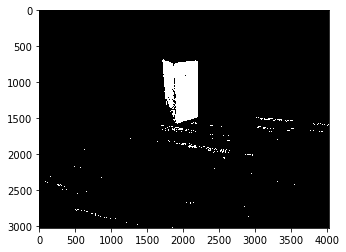

In [27]:
bw_copy = np.zeros(red_channel.shape)

i = 0
j = 0

for red_line, green_line, blue_line in zip(red_copy, green_copy, blue_copy):
    for red_value, green_value, blue_value in zip(red_line, green_line, blue_line):
        # Caso seja branco (todos os canais sao 255) os pixels são zerados:
        if (red_value == 255) and (green_value == 255) and (blue_value == 255):
            bw_copy[i][j] = 0
        # Caso seja amarelo (verde + vermelho) os pixels são zerados:
        elif (red_value == 255) and (green_value == 255) and (blue_value != 255):
            bw_copy[i][j] = 0
        # Caso seja magenta (azul + vermelho) os pixels são zerados:
        elif (red_value == 255) and (green_value != 255) and (blue_value == 255):
            bw_copy[i][j] = 0
        # Se a cor não é composta por vermelho (branco, amarelo e magenta) mantém o valor original do canal vermelho (isolando os vermelhos):
        else:
            bw_copy[i][j] = red_value
        j += 1
    j = 0
    i += 1
    
plt.imshow(bw_copy, cmap="Greys_r", vmin=0, vmax=255)
plt.show()

# Atividade 3


Abra a imagem `hall_box_battery_atividade3.png`  e a converta para tons de cinza de `0` a `255`.

Forneça como saída uma uma cópia da imagem  em que cada pixel  recebe o módulo da subtração entre o pixel que vem depois e o que vem antes dele (na horizontal).

Obs.: O conceito de *antes* e *depois* pode ser na horizontal ou na vertical

Apresente a imagem resultado, deve ficar parecida com a imagem `gabarito_atividade_3.png`.

<img src="gabarito_atividade_3.png" width=400>

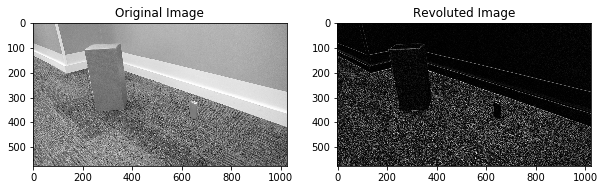

In [29]:
hallbox = cv2.cvtColor(cv2.imread("hall_box_battery_atividade3.png"), cv2.COLOR_BGR2GRAY)

hallbox_copy = np.zeros(hallbox.shape)

for i, line in enumerate(hallbox[1:-1]):
    for j, value in enumerate(line[1:-1]):
        hallbox_copy[i][j] = abs(int(hallbox[i+1][j]) - int(hallbox[i-1][j]))
        
plt.figure(figsize=(10, 6))

plt.subplot(121)
plt.imshow(hallbox, cmap='Greys_r')
plt.title("Original Image")

plt.subplot(122)
plt.imshow(hallbox_copy, cmap='Greys_r')
plt.title("Revoluted Image")

plt.show()